In [ ]:
#import libraries
from sklearn.feature_extraction.text import TfidfVectorizer


In [ ]:
!pip install vaderSentiment

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 126.0/126.0 kB 8.1 MB/s eta 0:00:00


In [ ]:
# Sample documents
documents = [
    "The cat sat on the mat",
    "The dog jumped over the fence",
    "The cat and dog are friends"
]

TF-IDF assigns higher weights to terms that are frequent in a document but
rare in the entire corpus, thus capturing their importance more accurately.

In [ ]:
# Create TF-IDF vectorizer
tfidf_vectorizer = TfidfVectorizer()

# Fit and transform the documents
tfidf_matrix = tfidf_vectorizer.fit_transform(documents)


# Get the feature names
feature_names = tfidf_vectorizer.get_feature_names_out()

# Print TF-IDF matrix
print(tfidf_matrix.toarray())

# Print feature names
print('\n')
print('feature_names:''\n',
      feature_names)

[[0.         0.         0.34101521 0.         0.         0.
  0.         0.44839402 0.44839402 0.         0.44839402 0.52965746]
 [0.         0.         0.         0.34101521 0.44839402 0.
  0.44839402 0.         0.         0.44839402 0.         0.52965746]
 [0.4711101  0.4711101  0.35829137 0.35829137 0.         0.4711101
  0.         0.         0.         0.         0.         0.27824521]]


feature_names:
 ['and' 'are' 'cat' 'dog' 'fence' 'friends' 'jumped' 'mat' 'on' 'over'
 'sat' 'the']


#### **Quick challenge:**
Could you spot the words which have low-score? Why do you think it is?

**Answer:**

The tf-idf values are 0 for the words that are not in the document.
For example, in the first document "The cat sat on the mat", the word "and" is not appearing, so tf-idf value is 0.

Words which are not significant and appears frequently have low tf-idf scores.
For example, cat has low score since it is occuring many times in the entire corpus.

Words which have more importance and appears less frequently have high tf-idf scores. For example, mat has higher score since it occurs only once in the entire corpus

#### **Applications of TF-IDF**

###### 1)Text Classification

###### 2)Clustering

###### 3)Information Retrival

#### **Simple movie review classification case study using TF-IDF text classification.**

About Dataset:
    
    IMDB dataset having 50K movie reviews for natural language processing or Text analytics.
    
    This is a dataset for binary sentiment classification containing substantially more data than previous benchmark datasets.
    We provide a set of 25,000 highly polar movie reviews for training and 25,000 for testing.
    
    So, predict the number of positive and negative reviews using either classification or deep learning algorithms.
    
    For more dataset information, please go through the following link,
    http://ai.stanford.edu/~amaas/data/sentiment/
    Data-set source: Kaggle


In this case study, we'll:

- 1) Prepare the dataset: We'll use the IMDb movie review dataset which consists of movie reviews labeled as positive or negative.
- 2) Preprocess the text data: We'll clean and preprocess the text data to remove noise and irrelevant information.
- 3) POS Tagging & NER: Use libraries such as NLTK or spaCy to perform POS tagging and Named Entity Recognition (NER) on the reviews.
- 4) Chunking: Apply chunking to the reviews using grammar-based patterns, which will help identify phrases or other syntactic elements.
- 5) Topic Modeling with LDA: Use Latent Dirichlet Allocation (LDA) to uncover common topics in the reviews, which can provide insights into recurring themes.
- 6) Vectorize the text using TF-IDF: We'll convert the text data into numerical features using TF-IDF.
- 7) Train a classifier: We'll train a classifier (Logistic Regression) to classify movie reviews as positive or negative.
- 8) Evaluate the classifier: We'll evaluate the classifier's performance on a test dataset.

In [ ]:
#import libraries
import pandas as pd
import numpy as np


#visualization
import plotly.graph_objects as go
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import seaborn as sns

#TFIDF
from sklearn.feature_extraction.text import TfidfVectorizer

#nlp
import re
import spacy
from textblob import TextBlob

#train-test split
#model

from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, accuracy_score, confusion_matrix

from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
import spacy


##### Question 1

- Please load your data below.
- Split the data into training and testing sets.


**Sample data snap-shot for your reference:**

![Screenshot 2024-10-30 at 11.52.26 AM.png](attachment:157fc9a0-5713-44ad-a617-cfee4d03848e.png)


In [ ]:
# Load the dataset
data = pd.read_csv('movie_reviews.csv')

In [ ]:
data.head()

,review,sentiment
0,One of the other reviewers has mentioned that ...,positive
1,A wonderful little production. <br /><br />The...,positive
2,I thought this was a wonderful way to spend ti...,positive
3,Basically there's a family where a little boy ...,negative
4,"Petter Mattei's ""Love in the Time of Money"" is...",positive


In [ ]:
#split your data
X = data['review']
y = data['sentiment']

# Fill in the data and split ratio (e.g., test_size=0.2 for 20% testing)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)


In [ ]:
print("Count of training dataset ",X_train.count())
print("Count of training dataset ",X_test.count())

Count of training dataset  35000
Count of training dataset  15000


### Question 2:

- Add EDA below(Make sure to change the variables)
  - Sentiment Distribution Visualization
  - Sentiment Polarity
  - Word Count Analysis

In [ ]:
#EDA

#looking at the few data lines
data.review[1]

'A wonderful little production. <br /><br />The filming technique is very unassuming- very old-time-BBC fashion and gives a comforting, and sometimes discomforting, sense of realism to the entire piece. <br /><br />The actors are extremely well chosen- Michael Sheen not only "has got all the polari" but he has all the voices down pat too! You can truly see the seamless editing guided by the references to Williams\' diary entries, not only is it well worth the watching but it is a terrificly written and performed piece. A masterful production about one of the great master\'s of comedy and his life. <br /><br />The realism really comes home with the little things: the fantasy of the guard which, rather than use the traditional \'dream\' techniques remains solid then disappears. It plays on our knowledge and our senses, particularly with the scenes concerning Orton and Halliwell and the sets (particularly of their flat with Halliwell\'s murals decorating every surface) are terribly well d

In [ ]:
data.sentiment[1]

'positive'

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50000 entries, 0 to 49999
Data columns (total 2 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   review     50000 non-null  object
 1   sentiment  50000 non-null  object
dtypes: object(2)
memory usage: 781.4+ KB


In [ ]:
data.describe()

,review,sentiment
count,50000,50000
unique,49582,2
top,Loved today's show!!! It was a variety and not...,positive
freq,5,25000


#### Sentiment Distribution Visualization
Please feel free to innovate.
Sample chart below:
![Screenshot 2024-10-30 at 12.11.44 PM.png](attachment:3b92a95f-0c56-4eb2-9ee9-e2e9a20f774b.png)

In [ ]:
 #visualize the sentiment column
 sentiment_count = data.sentiment.value_counts()
 print(sentiment_count)

sentiment
positive    25000
negative    25000
Name: count, dtype: int64


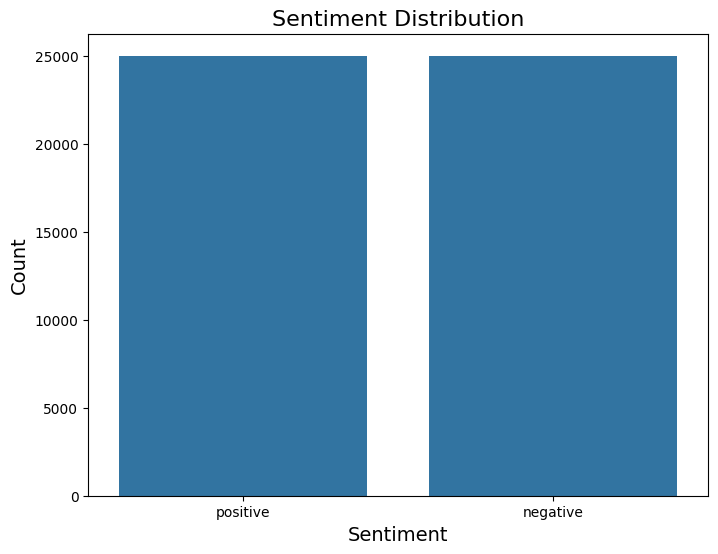

In [ ]:
# Sentiment Distribution Visualization

# Sentiment Distribution Visualization
plt.figure(figsize=(8, 6))
sns.countplot(x='sentiment', data=data)
plt.title('Sentiment Distribution', fontsize=16)
plt.xlabel('Sentiment', fontsize=14)
plt.ylabel('Count', fontsize=14)
plt.show()

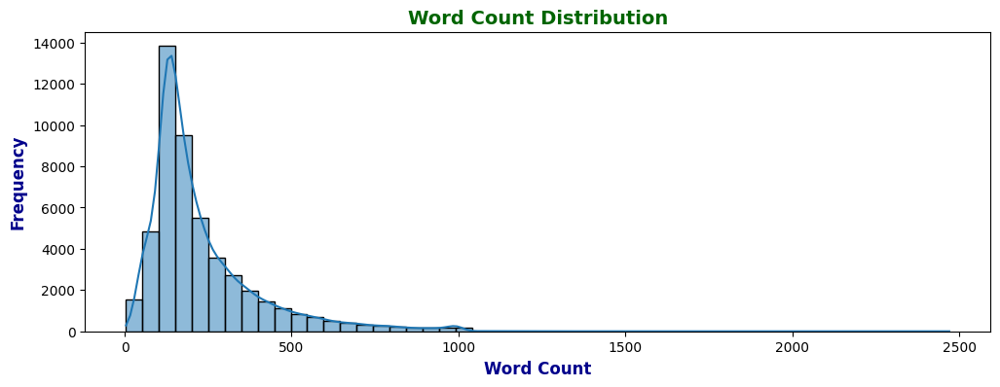

In [ ]:
# Word Count Analysis
data['word_count'] = data['review'].apply(lambda x: len(str(x).split()))

# Visualization
plt.figure(figsize=(12, 4))
sns.histplot(data['word_count'], bins=50, kde=True)
plt.title('Word Count Distribution', fontsize = 14, fontweight = 'bold', color = 'darkgreen')
plt.xlabel('Word Count', fontsize = 12, fontweight = 'bold', color = 'darkblue')
plt.ylabel('Frequency', fontsize = 12, fontweight = 'bold', color = 'darkblue')
plt.show()

<Axes: xlabel='sentiment_polarity', ylabel='Count'>

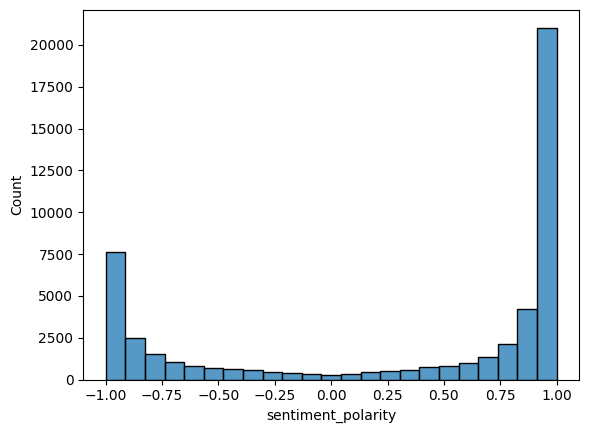

In [ ]:
analyzer = SentimentIntensityAnalyzer()

data['sentiment_polarity'] = data['review'].apply(lambda x: analyzer.polarity_scores(x)['compound'])
sns.histplot(data['sentiment_polarity'])


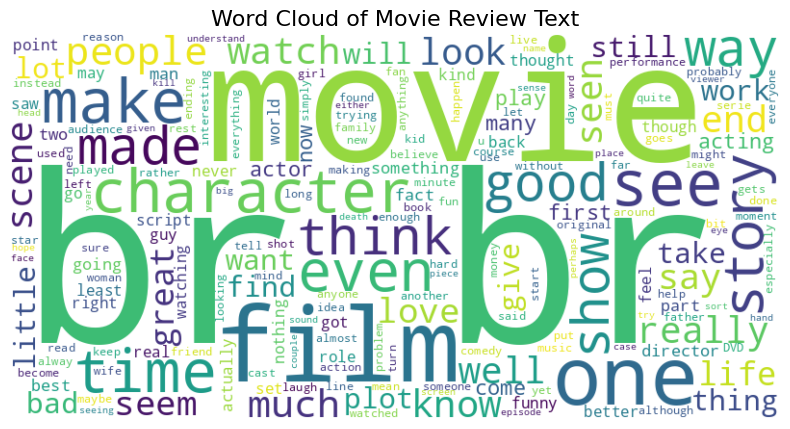

In [ ]:
# word cloud for review

# Assuming 'X_train' contains your movie review text data
text = ' '.join(X.tolist())

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(text)

# Display the word cloud
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Movie Review Text', fontsize=16)
plt.show()

### Question 3:

- Text Preprocessing
  - Check if there are missing values
  - Tokenize words
  - Remove punctuations
  - Lowercase all the words

In [ ]:
import nltk
nltk.download('punkt')
nltk.download('stopwords')

def preprocess(text):

    #check if missing values
    if pd.isnull(text) or text.strip() == '':
      return None
    # Tokenize and lowercase
    tokens = word_tokenize(text.lower())
    # Remove punctuation
    tokens = [token for token in tokens if token.isalpha()]

    # Uncomment below if using Option B (Stop words removal)
    from nltk.corpus import stopwords

    stop_words = set(stopwords.words("english"))
    tokens = [token for token in tokens if token not in stop_words]

    return " ".join(tokens)

X_train = X_train.apply(preprocess)
X_test = X_test.apply(preprocess)


[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


In [ ]:
#duplicated data


# Calculate sentiment polarity for each review
def get_sentiment_polarity(text):
    analysis = TextBlob(text)
    return analysis.sentiment.polarity

data['Sentiment_Polarity'] = data['review'].apply(get_sentiment_polarity)


In [ ]:
data

,review,sentiment,word_count,sentiment_polarity,Sentiment_Polarity
0,One of the other reviewers has mentioned that ...,positive,307,-0.9916,0.023433
1,A wonderful little production. <br /><br />The...,positive,162,0.9670,0.109722
2,I thought this was a wonderful way to spend ti...,positive,166,0.9519,0.354008
3,Basically there's a family where a little boy ...,negative,138,-0.9213,-0.057813
4,"Petter Mattei's ""Love in the Time of Money"" is...",positive,230,0.9744,0.217952
...,...,...,...,...,...
49995,I thought this movie did a down right good job...,positive,194,0.9886,0.394425
49996,"Bad plot, bad dialogue, bad acting, idiotic di...",negative,112,-0.6837,-0.276190
49997,I am a Catholic taught in parochial elementary...,negative,230,-0.9734,0.056984
49998,I'm going to have to disagree with the previou...,negative,212,-0.8657,-0.048663


### **Tf-idf sample**


In [ ]:
# #lets use the TF_IDF to detect the missing values

# #converting the empty strings to fill w/ NaN
data['review1'] = [ t if t else float('NaN') for t in data['review']]

if data['review1'].isnull().any():
    print("There are missing values in the 'review1' column.")
else:
    print("There are no missing values in the 'review1' column.")

# # Initialize TF-IDF vectorizer
tfidf_vectorizer = TfidfVectorizer()

# # Fit and transform text data into TF-IDF features
tfidf_matrix = tfidf_vectorizer.fit_transform(data)
print(tfidf_matrix)
# # Convert TF-IDF matrix to DataFrame
tfidf_df = pd.DataFrame(tfidf_matrix.toarray(), columns=tfidf_vectorizer.get_feature_names_out())

# # Create a mask for missing values
mask1 = tfidf_df.isnull()

# # Create a heatmap
fig = go.Figure(data=go.Heatmap(z=mask1,colorscale='Viridis',showscale=False ))

# # Add labels to x and y axis
fig.update_layout(
title="Missing Values Heatmap", xaxis_title="Features", yaxis_title="Rows")


There are no missing values in the 'review1' column.
  (0, 0)	1.0
  (1, 2)	1.0
  (2, 4)	1.0
  (3, 3)	1.0
  (4, 3)	1.0
  (5, 1)	1.0


**Answer:**

**Insights of TF-IDF:** It can be observed from the graph that there are no missing values

In [ ]:
tfidf_df

,review,review1,sentiment,sentiment_polarity,word_count
0,1.0,0.0,0.0,0.0,0.0
1,0.0,0.0,1.0,0.0,0.0
2,0.0,0.0,0.0,0.0,1.0
3,0.0,0.0,0.0,1.0,0.0
4,0.0,0.0,0.0,1.0,0.0
5,0.0,1.0,0.0,0.0,0.0


### Question 4:  POS Tagging and NER

Choose one:

- Option A: POS tagging with NLTK [averaged_perceptron_tagger](https://www.nltk.org/_modules/nltk/tag/perceptron.html)
- Option B: POS tagging and NER with spaCy


In [ ]:
# Option A: Using NLTK for POS tagging
import nltk
nltk.download('averaged_perceptron_tagger')

# POS tagging
pos_tags_train = [nltk.pos_tag(nltk.word_tokenize(review)) for review in X_train]

# Option B: Using spaCy for POS tagging and NER
#import spacy
# = spacy.load("en_core_web_sm")

# POS and NER tagging
#pos_tags_train = [[(token.text, token.pos_) for token in nlp(review)] for review in X_train]
#ner_train = [[(ent.text, ent.label_) for ent in nlp(review).ents] for review in X_train]


[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger.zip.


In [ ]:
pos_tags_train[1]

[('good', 'JJ'),
 ('ppv', 'NN'),
 ('like', 'IN'),
 ('wrestlemania', 'NN'),
 ('xx', 'CD'),
 ('years', 'NNS'),
 ('later', 'RB'),
 ('wwe', 'VBD'),
 ('crammed', 'VBD'),
 ('many', 'JJ'),
 ('matches', 'NNS'),
 ('matches', 'NNS'),
 ('useless', 'RB'),
 ('going', 'VBG'),
 ('go', 'VB'),
 ('every', 'DT'),
 ('match', 'NN'),
 ('card', 'NN'),
 ('would', 'MD'),
 ('take', 'VB'),
 ('forever', 'RB'),
 ('br', 'RB'),
 ('br', 'VB'),
 ('however', 'RB'),
 ('major', 'JJ'),
 ('highlights', 'NNS'),
 ('included', 'VBD'),
 ('huge', 'JJ'),
 ('pop', 'NN'),
 ('demolition', 'NN'),
 ('winning', 'VBG'),
 ('tag', 'NN'),
 ('team', 'NN'),
 ('belts', 'NNS'),
 ('haku', 'VBD'),
 ('andre', 'NN'),
 ('giant', 'NN'),
 ('first', 'JJ'),
 ('ever', 'RB'),
 ('mixed', 'JJ'),
 ('tag', 'JJ'),
 ('match', 'NN'),
 ('featuring', 'VBG'),
 ('randy', 'JJ'),
 ('savage', 'NN'),
 ('sensational', 'JJ'),
 ('queen', 'JJ'),
 ('sherri', 'NN'),
 ('vs', 'NN'),
 ('dusty', 'JJ'),
 ('rhodes', 'NNS'),
 ('late', 'JJ'),
 ('sapphire', 'NN'),
 ('first', 'RB'),


**Insights of POS tagging:**

Option A is chosen - Using NLTK for POS tagging

### Question 5: Chunking


**What is Chunking?**
Chunking is a Natural Language Processing (NLP) technique used to identify and extract meaningful phrases, also known as "chunks," from a sentence. Unlike individual word tagging (such as Part-of-Speech or POS tagging), chunking groups words into larger, syntactically related units, like noun phrases, verb phrases, adjective phrases, etc.

**Why Chunking is Useful**
Chunking helps capture meaningful groups of words, which can be essential for understanding the context in sentences.

For example:

    - Noun phrases can capture entities or subjects (e.g., “the fantastic movie”).
    - Verb phrases can identify actions or activities (e.g., “was very entertaining”).
    - Adjective phrases provide descriptive information (e.g., “extremely engaging”).

This process helps extract more complex information from text, which can be particularly valuable in tasks like:

    - Information Retrieval: Extracting key concepts or topics.
    - Sentiment Analysis: Identifying descriptive phrases associated with opinions.
    - Text Summarization: Finding core information to summarize large texts.

**How Chunking Works**
Chunking is done using grammar rules that define patterns of word sequences.

For example:

     -A simple noun phrase rule might capture any sequence starting with an optional determiner (like "the") followed by zero or more adjectives and ending with a noun.
      Consider the sentence:
      "The movie was fantastic and very entertaining."

        Using chunking rules, we might capture chunks like:

        Noun Phrase (NP): "The movie"
        Adjective Phrase (ADJP): "fantastic" or "very entertaining"

**How to Apply Chunking**
In NLP, we often use regular expressions to define patterns for these phrases. For example, the rule "NP:{<DT>?<JJ>*<NN>}" captures noun phrases, where:

<DT> represents a determiner (like "the" or "a").
<JJ> represents an adjective.
<NN> represents a noun.
By defining different rules, we can capture various types of phrases, which gives us flexibility in analyzing the text.
    

    
    
**In the project, you’ll try different rules to observe how each affects the type and amount of information extracted.**

- **Chunking**: Extract noun phrases using grammar-based rules
            - Explanation of Rules:
                - Noun Phrases (NP): Capture singular, plural, and proper noun phrases.
                - Verb Phrases (VP): Capture sequences with verbs, optionally including modal verbs.
                - Prepositional Phrases (PP): Capture prepositions followed by noun phrases.
                - Adjective and Adverbial Phrases (ADJP, ADVP): Capture descriptive phrases, often adding more context around nouns and actions.
                
                Instruction 1. Choose an Option: Select one of the chunking options (A, B, or C) based on the types of phrases you want to extract.
                                Option A: Basic Noun Phrase (NP) Extraction.This option captures simple noun phrases (nouns with optional adjectives).
                                Option B: Noun and Verb Phrases (NP, VP).This option extracts both noun phrases and verb phrases to capture key actions and subjects.
                                Option C: Comprehensive Chunking (NP, VP, PP, ADJP).
                                          This option provides a more comprehensive extraction,allowing to capture more contextual information from review
               Instruction 2.Observe Output: Run the chosen option on pos_tags_train to observe the phrases captured from each review.
               Instruction 3.Analysis: Compare how each option impacts the captured information and discuss which option might be most effective for analyzing movie reviews.
                





                


In [ ]:
# Define grammar rules for multiple phrase types
grammar = r"""
NP: {<DT>?<JJ>*<NN>}
"""

def extract_chunks(pos_tags):
    cp = nltk.RegexpParser(grammar)
    tree = cp.parse(pos_tags)
    iob_tagged = nltk.chunk.tree2conlltags(tree)
    return iob_tagged

chunked_train = [extract_chunks(tags) for tags in pos_tags_train]
chunked_train

[[('much', 'JJ', 'B-NP'),
  ('love', 'NN', 'I-NP'),
  ('trains', 'NNS', 'O'),
  ('could', 'MD', 'O'),
  ('stomach', 'VB', 'O'),
  ('movie', 'NN', 'B-NP'),
  ('premise', 'NN', 'B-NP'),
  ('one', 'CD', 'O'),
  ('could', 'MD', 'O'),
  ('steal', 'VB', 'O'),
  ('locomotive', 'JJ', 'B-NP'),
  ('drive', 'NN', 'I-NP'),
  ('arkansas', 'NN', 'B-NP'),
  ('chicago', 'NN', 'B-NP'),
  ('without', 'IN', 'O'),
  ('hitting', 'VBG', 'O'),
  ('another', 'DT', 'B-NP'),
  ('train', 'NN', 'I-NP'),
  ('along', 'IN', 'O'),
  ('way', 'NN', 'B-NP'),
  ('right', 'JJ', 'B-NP'),
  ('impossible', 'JJ', 'I-NP'),
  ('plot', 'NN', 'I-NP'),
  ('lines', 'NNS', 'O'),
  ('hit', 'VBD', 'O'),
  ('board', 'NN', 'B-NP'),
  ('imagine', 'NN', 'B-NP'),
  ('two', 'CD', 'O'),
  ('disgruntled', 'VBD', 'O'),
  ('nasa', 'NNS', 'O'),
  ('employees', 'NNS', 'O'),
  ('stealing', 'VBG', 'O'),
  ('crawler', 'NN', 'B-NP'),
  ('totes', 'NNS', 'O'),
  ('shuttles', 'NNS', 'O'),
  ('fro', 'VBP', 'O'),
  ('driving', 'VBG', 'O'),
  ('new', 'JJ',

In [ ]:
# Define grammar rules for multiple phrase types
grammar = r"""
VP: {<MD>?<VB.*><NP|PP>*}
"""

def extract_chunks(pos_tags):
    cp = nltk.RegexpParser(grammar)
    tree = cp.parse(pos_tags)
    iob_tagged = nltk.chunk.tree2conlltags(tree)
    return iob_tagged

chunked_train = [extract_chunks(tags) for tags in pos_tags_train]
chunked_train

[[('much', 'JJ', 'O'),
  ('love', 'NN', 'O'),
  ('trains', 'NNS', 'O'),
  ('could', 'MD', 'B-VP'),
  ('stomach', 'VB', 'I-VP'),
  ('movie', 'NN', 'O'),
  ('premise', 'NN', 'O'),
  ('one', 'CD', 'O'),
  ('could', 'MD', 'B-VP'),
  ('steal', 'VB', 'I-VP'),
  ('locomotive', 'JJ', 'O'),
  ('drive', 'NN', 'O'),
  ('arkansas', 'NN', 'O'),
  ('chicago', 'NN', 'O'),
  ('without', 'IN', 'O'),
  ('hitting', 'VBG', 'B-VP'),
  ('another', 'DT', 'O'),
  ('train', 'NN', 'O'),
  ('along', 'IN', 'O'),
  ('way', 'NN', 'O'),
  ('right', 'JJ', 'O'),
  ('impossible', 'JJ', 'O'),
  ('plot', 'NN', 'O'),
  ('lines', 'NNS', 'O'),
  ('hit', 'VBD', 'B-VP'),
  ('board', 'NN', 'O'),
  ('imagine', 'NN', 'O'),
  ('two', 'CD', 'O'),
  ('disgruntled', 'VBD', 'B-VP'),
  ('nasa', 'NNS', 'O'),
  ('employees', 'NNS', 'O'),
  ('stealing', 'VBG', 'B-VP'),
  ('crawler', 'NN', 'O'),
  ('totes', 'NNS', 'O'),
  ('shuttles', 'NNS', 'O'),
  ('fro', 'VBP', 'B-VP'),
  ('driving', 'VBG', 'B-VP'),
  ('new', 'JJ', 'O'),
  ('york', 'NN

In [ ]:
# Define grammar rules for multiple phrase types
grammar = r"""
ADJP: {<RB>*<JJ>+}
"""

def extract_chunks(pos_tags):
    cp = nltk.RegexpParser(grammar)
    tree = cp.parse(pos_tags)
    iob_tagged = nltk.chunk.tree2conlltags(tree)
    return iob_tagged

chunked_train = [extract_chunks(tags) for tags in pos_tags_train]
chunked_train

[[('much', 'JJ', 'B-ADJP'),
  ('love', 'NN', 'O'),
  ('trains', 'NNS', 'O'),
  ('could', 'MD', 'O'),
  ('stomach', 'VB', 'O'),
  ('movie', 'NN', 'O'),
  ('premise', 'NN', 'O'),
  ('one', 'CD', 'O'),
  ('could', 'MD', 'O'),
  ('steal', 'VB', 'O'),
  ('locomotive', 'JJ', 'B-ADJP'),
  ('drive', 'NN', 'O'),
  ('arkansas', 'NN', 'O'),
  ('chicago', 'NN', 'O'),
  ('without', 'IN', 'O'),
  ('hitting', 'VBG', 'O'),
  ('another', 'DT', 'O'),
  ('train', 'NN', 'O'),
  ('along', 'IN', 'O'),
  ('way', 'NN', 'O'),
  ('right', 'JJ', 'B-ADJP'),
  ('impossible', 'JJ', 'I-ADJP'),
  ('plot', 'NN', 'O'),
  ('lines', 'NNS', 'O'),
  ('hit', 'VBD', 'O'),
  ('board', 'NN', 'O'),
  ('imagine', 'NN', 'O'),
  ('two', 'CD', 'O'),
  ('disgruntled', 'VBD', 'O'),
  ('nasa', 'NNS', 'O'),
  ('employees', 'NNS', 'O'),
  ('stealing', 'VBG', 'O'),
  ('crawler', 'NN', 'O'),
  ('totes', 'NNS', 'O'),
  ('shuttles', 'NNS', 'O'),
  ('fro', 'VBP', 'O'),
  ('driving', 'VBG', 'O'),
  ('new', 'JJ', 'B-ADJP'),
  ('york', 'NN', 'O

In [ ]:
# Define grammar rules for multiple phrase types
grammar = r"""
ADVP: {<RB><RB>*}
"""

def extract_chunks(pos_tags):
    cp = nltk.RegexpParser(grammar)
    tree = cp.parse(pos_tags)
    iob_tagged = nltk.chunk.tree2conlltags(tree)
    return iob_tagged

chunked_train = [extract_chunks(tags) for tags in pos_tags_train]
chunked_train

[[('much', 'JJ', 'O'),
  ('love', 'NN', 'O'),
  ('trains', 'NNS', 'O'),
  ('could', 'MD', 'O'),
  ('stomach', 'VB', 'O'),
  ('movie', 'NN', 'O'),
  ('premise', 'NN', 'O'),
  ('one', 'CD', 'O'),
  ('could', 'MD', 'O'),
  ('steal', 'VB', 'O'),
  ('locomotive', 'JJ', 'O'),
  ('drive', 'NN', 'O'),
  ('arkansas', 'NN', 'O'),
  ('chicago', 'NN', 'O'),
  ('without', 'IN', 'O'),
  ('hitting', 'VBG', 'O'),
  ('another', 'DT', 'O'),
  ('train', 'NN', 'O'),
  ('along', 'IN', 'O'),
  ('way', 'NN', 'O'),
  ('right', 'JJ', 'O'),
  ('impossible', 'JJ', 'O'),
  ('plot', 'NN', 'O'),
  ('lines', 'NNS', 'O'),
  ('hit', 'VBD', 'O'),
  ('board', 'NN', 'O'),
  ('imagine', 'NN', 'O'),
  ('two', 'CD', 'O'),
  ('disgruntled', 'VBD', 'O'),
  ('nasa', 'NNS', 'O'),
  ('employees', 'NNS', 'O'),
  ('stealing', 'VBG', 'O'),
  ('crawler', 'NN', 'O'),
  ('totes', 'NNS', 'O'),
  ('shuttles', 'NNS', 'O'),
  ('fro', 'VBP', 'O'),
  ('driving', 'VBG', 'O'),
  ('new', 'JJ', 'O'),
  ('york', 'NN', 'O'),
  ('get', 'NN', 'O'),

**Insights of Chunking:**

Chunking with four different grammer regex - NP, VP, ADJP, ADVP has been done and it can be seen that for movie review sentiment analysis, ADJP and ADVP will be more accurate than NP and VP

### Question 6: Apply Latent Dirichlet Allocation to find topics

Step: Displaying LDA Topics
- Fit the LDA Model: After transforming the text data using TF-IDF, we fit an LDA model to uncover topics in the dataset.
- Display the Top Words in Each Topic: For each topic, we can display the most significant words, which help interpret the main themes in each topic.
- Visualization(optional): We can visualize the topics using word clouds for more intuitive understanding


In [ ]:
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.feature_extraction.text import TfidfVectorizer

 # Fill in the vectorizer with max_features (example: 100,200,5000 etc)
vectorizer = TfidfVectorizer(max_features=100)
X_train_tfidf = vectorizer.fit_transform(X_train)



# # Fill in the number of topics (example: 2,5 etc)
lda = LatentDirichletAllocation(n_components=5, random_state=42)
lda.fit(X_train_tfidf)



# # Display topics

# # Function to display the top words in each topic
def display_topics(model, feature_names, no_top_words=10):
     for topic_idx, topic in enumerate(model.components_):
         print(f"Topic #{topic_idx + 1}:")
         # Fill in to print top words in each topic
         print(" ".join([feature_names[i] for i in topic.argsort()[:-no_top_words  - 1:-1]]))
         print("\n")

# # Get feature names from the vectorizer and display topics
tfidf_feature_names = vectorizer.get_feature_names_out()
display_topics(lda, tfidf_feature_names, no_top_words=10)



Topic #1:
br film movie like one plot really even get would


Topic #2:
movie br show bad like funny would one watch good


Topic #3:
movie film br love one life story great like see


Topic #4:
movie film one horror good br movies like films great


Topic #5:
br film one story movie young also well two films




In [ ]:
tfidf_feature_names

array(['acting', 'actors', 'actually', 'also', 'another', 'around',
       'back', 'bad', 'best', 'better', 'big', 'br', 'ca', 'cast',
       'character', 'characters', 'could', 'director', 'end', 'enough',
       'even', 'ever', 'every', 'fact', 'film', 'films', 'find', 'first',
       'funny', 'get', 'give', 'go', 'going', 'good', 'got', 'great',
       'horror', 'however', 'know', 'life', 'like', 'little', 'long',
       'look', 'lot', 'love', 'made', 'make', 'makes', 'man', 'many',
       'may', 'movie', 'movies', 'much', 'must', 'never', 'new',
       'nothing', 'old', 'one', 'original', 'part', 'people', 'plot',
       'pretty', 'quite', 'real', 'really', 'right', 'say', 'scene',
       'scenes', 'see', 'seems', 'seen', 'show', 'something', 'still',
       'story', 'take', 'thing', 'things', 'think', 'though', 'thought',
       'time', 'two', 'us', 'want', 'watch', 'watching', 'way', 'well',
       'without', 'work', 'world', 'would', 'years', 'young'],
      dtype=object)

### Please provide answers to the following:

- Interpret Topics: Based on the top words in each topic, what themes or aspects of movie reviews do you think each topic represents?
- Topic Number Choice: Experiment with different values for n_components. How does the number of topics affect the results? Does a higher or lower number of topics provide better thematic coverage?
- Visualization Insights: How does the word cloud visualization help interpret each topic? Are there any unexpected themes or patterns?

**Answers:**

**Interpret Topics**

Topic #1: Words like "plot," "really," "even," and "would" indicate a strong focus on the storyline and may reflect polarized views on plot quality.

Topic #2: Words like "bad," "funny," and "good" imply a broad assessment of enjoyment, possibly reflecting sentiment about the films overall entertainment value.

Topic #3: Words such as "love," "life," and "story" may indicate reviews centered on deeply affecting or meaningful content.

Topic #4: Words like "horror" and "films" hint that this topic is mostly about horror movies, though general words like "good" and "great" suggest varied opinions within the genre.

Topic #5: Words like "young," "story," "well," and "two" might indicate movies that explore youth, relationships, or family dynamics.

**Topic Number Choice**

Higher number of topics (e.g., 10 or more): This tends to result in more topics, possibly identifying sub-genres (e.g., specific tropes or themes in horror or comedy).

Lower number of topics (e.g., 2-3): This can give broader, more general topics that are easier to interpret but may lack the nuanced representation of themes within the data.

Finding the optimal number often requires a balance. For general themes, a range between 5-7 topics usually provides a good mix of interpretability and topic distinctiveness in typical movie review datasets.

**Visualization Insights with Word Clouds**
Word clouds are especially helpful for interpreting topics because they show the relative importance of words at a glance, with frequent words appearing larger.

### Question 7: Model Training with TF-IDF Vectorization
Fill in the blanks for TF-IDF vectorization and Logistic Regression(or any of your choice) model training.

In [ ]:
# Vectorize the test data
X_test_tfidf = vectorizer.transform(X_test)

# Train the classifier
from sklearn.linear_model import LogisticRegression
model = LogisticRegression(max_iter=100)
model.fit(X_train_tfidf, y_train)  # Fill in X_train_tfidf and y_train

# Predict on the test set
y_pred = model.predict(X_test_tfidf)  # Fill in X_test_tfidf


### Question 8:Model Evaluation
Evaluate the model by calculating accuracy, precision, and recall.

In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, classification_report

# Fill in to calculate accuracy, precision, and recall
accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred,pos_label='positive')
recall = recall_score(y_test, y_pred,pos_label='positive')
classification_rep = classification_report(y_test, y_pred)

print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("Classification Report:\n", classification_rep)


Accuracy: 0.732
Precision: 0.731302657161374
Recall: 0.7434444590855185
Classification Report:
               precision    recall  f1-score   support

    negative       0.73      0.72      0.73      7411
    positive       0.73      0.74      0.74      7589

    accuracy                           0.73     15000
   macro avg       0.73      0.73      0.73     15000
weighted avg       0.73      0.73      0.73     15000



**Naive bayes model for classification**

In [ ]:
#naive bayes for classification
# Vectorize the test data
X_test_tfidf = vectorizer.transform(X_test)

# training the model on training set
from sklearn.naive_bayes import GaussianNB
gnb = GaussianNB()
X_train_tfidf_dense = X_train_tfidf.toarray()
gnb.fit(X_train_tfidf_dense, y_train)

# making predictions on the testing set
X_test_tfidf_dense = X_test_tfidf.toarray()
y_pred = gnb.predict(X_test_tfidf_dense)

In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, classification_report

# Fill in to calculate accuracy, precision, and recall
accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred,pos_label='positive')
recall = recall_score(y_test, y_pred,pos_label='positive')
classification_rep = classification_report(y_test, y_pred)

print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("Classification Report:\n", classification_rep)


Accuracy: 0.7083333333333334
Precision: 0.7139243876464324
Recall: 0.7066807220977731
Classification Report:
               precision    recall  f1-score   support

    negative       0.70      0.71      0.71      7411
    positive       0.71      0.71      0.71      7589

    accuracy                           0.71     15000
   macro avg       0.71      0.71      0.71     15000
weighted avg       0.71      0.71      0.71     15000



It can be observed that using Logistic Regression gives accuracy of 73.2% whereas Naive bayes given less accuracy of 70.8%